## RKHS

In [1]:
from lbfgsb_scipy import LBFGSBScipy
import torch
import torch.nn as nn
import numpy as np
import math
import matplotlib.pyplot as plt
from trace_expm import trace_expm
import numpy.linalg as la
import time

from concurrent.futures import ProcessPoolExecutor
from sklearn.preprocessing import StandardScaler


In [2]:
torch.set_default_dtype(torch.float64)

In [3]:
class NotearsRKHS(nn.Module):
    """n: number of samples, d: num variables"""
    def __init__(self, n, d, kernel):
        super(NotearsRKHS, self).__init__() # inherit  nn.Module
        self.d = d
        self.n = n
        self.kernel = kernel

        #torch.manual_seed(42)

        # initialize coefficients alpha
        self.alpha = nn.Linear(n, d, bias=False)  # alpha.weight = [d, n], alpha(x) = x @ alpha.weight^T
        nn.init.zeros_(self.alpha.weight)

        # initialize coefficients beta
        beta = torch.zeros(d, d, n)
        #beta = torch.randn(d, d, n)
        self.beta = nn.Parameter(beta) # beta^j_{a, l}: for estimation of jth random variable at lth observation with help of gradient of K wrt ath coordinate 


        self.I = torch.eye(self.d)
    
    
    def get_parameters(self): # [d, n]
       alpha = self.alpha.weight
       beta = self.beta
       return alpha, beta
    
    #@timing_decorator
    @torch.no_grad()
    def gaussian_kernel_matrix_and_grad(self, x, gamma=1): 
      # x: [n, d]; K: [n, n]; grad_K1: [n, n, d]: gradient of k(x^i, x^l) wrt x^i_{k}; grad_K2: [n, n, d]: gradient of k(x^i, x^l) wrt x^l_{k}; mixed_grad: [n, n, d, d] gradient of k(x^i, x^l) wrt x^i_{a} and x^l_{b}
      #x = torch.tensor(x, requires_grad=True) 
      # Compute pairwise squared Euclidean distances using broadcasting
      diff = x.unsqueeze(1) - x.unsqueeze(0) # [n, n, d]
      sq_dist = torch.sum(diff ** 2, dim=2)

      # Compute the Gaussian kernel matrix
      K = torch.exp(-sq_dist / (gamma ** 2)) # [n, n]
      # Compute the gradient of K with respect to X
      grad_K1 = -2 * diff / (gamma ** 2) * K.unsqueeze(2) # K.unsqueeze(2): [n, n, 1]
      grad_K2 = -grad_K1

      outer_products_diff = torch.einsum('ijl, ijk->ijlk', diff, diff)  # Outer product of the differences [n, n, d, d]
      K_reshape = K.view(self.n, self.n, 1, 1)
      mixed_grad = (-4 / gamma**4) * outer_products_diff  * K_reshape  # Apply the formula for i != j [n, n, d, d]

      # Diagonal elements (i == j) need an additional term
      K_expanded = torch.einsum('ij,kl->ijkl', K, self.I)
      mixed_grad += 2/gamma**2 * K_expanded

      return K, grad_K1, grad_K2, mixed_grad
    
    #@timing_decorator
    @torch.no_grad()
    def matern3_2_kernel_matrix_and_grad(self, x, gamma=1): # K: [n, n]; grad_K: [n, n, d]: gradient of k(x^l, x^i) wrt x^l_{a}
       #x = torch.tensor(x, requires_grad=True)
       diff = x.unsqueeze(1) - x.unsqueeze(0) #[n, n, d]
       dist = torch.sqrt(torch.sum(diff ** 2, dim=2)) #[n, n]
       K = (1 + np.sqrt(3)*dist / gamma)*torch.exp(-np.sqrt(3)*dist / gamma) #[n, n]
       temp = -3/(gamma**2)*torch.exp(-np.sqrt(3)*dist/gamma) #[n, n]
       grad_K = diff*temp.unsqueeze(2)

       return K, grad_K
    
    #@timing_decorator
    @torch.no_grad()
    def matern5_2_kernel_matrix_and_grad(self, x, gamma=1): # [n, n, d]: gradient of k(x^i, x^l) wrt x^i_{k}
       #x = torch.tensor(x, requires_grad=True)
       diff = x.unsqueeze(1) - x.unsqueeze(0) #[n, n, d]
       dist = torch.sqrt(torch.sum(diff ** 2, dim=2)) #[n, n]
       K = (1 + np.sqrt(5)*dist / gamma + 5*(dist**2)/(3*(gamma**2)))*torch.exp(-np.sqrt(5)*dist / gamma)
       temp = (-5/(3*gamma**2) - 5*np.sqrt(5)*dist/(3*(gamma**3)))*torch.exp(-np.sqrt(5)*dist/gamma) #[n, n]
       grad_K = diff*temp.unsqueeze(2)

       return K, grad_K
    
    # @torch.no_grad()
    # def polynomial_kernel_matrix_and_grad(self, x, c=1, degree=3): # x: [n, d]; K: [n, n]; grad_K: [n, n, d]: gradient of k(x^i, x^l) wrt x^i_{k}
    #   #x = torch.tensor(x, requires_grad=True) 
    #   # Compute pairwise squared Euclidean distances using broadcasting
    #   mul = x.unsqueeze(1)*x.unsqueeze(0) # [n, n, d]

    #   # Compute the Gaussian kernel matrix
    #   K = (mul + c)**degree # [n, n]
    #   # Compute the gradient of K with respect to X
    #   grad_K = -2 * diff / (gamma ** 2) * K.unsqueeze(2) # K.unsqueeze(2): [n, n, 1]

    #   return K, grad_K
    
    #@timing_decorator
    def forward(self, x: torch.tensor): #[n, d] -> [n, d], forward(x)_{i,j} = estimation of x_j at ith observation 
      """
      x: data matrix of shape [n, d] (np.array)
      forward(x)_{l,j} = estimation of x_j at lth observation
      """
      if self.kernel == "gaussian":
        K = self.gaussian_kernel_matrix_and_grad(x)[0]
        #grad_K1 = self.gaussian_kernel_matrix_and_grad(x)[1]
        grad_K2 = self.gaussian_kernel_matrix_and_grad(x)[2]
      elif self.kernel == "matern3_2":
        K = self.matern3_2_kernel_matrix_and_grad(x)[0]
        grad_K2 = self.matern3_2_kernel_matrix_and_grad(x)[2]
      elif self.kernel == "matern5_2":
        K = self.matern5_2_kernel_matrix_and_grad(x)[0]
        grad_K2 = self.matern5_2_kernel_matrix_and_grad(x)[2]
      else:
        print("Given kernel is invalid.")
        
      output1 = self.alpha(K) # [n, d]
      output2 = torch.einsum('jal, ila -> jil', self.beta, grad_K2) # [d, n, n]
      output2 = torch.sum(output2, dim = 2) # [d, n]
      output2 = output2.t() # [n, d]
      output = output1 + output2 # [n, d]
      return output
      #return output1, output2


    #@timing_decorator
    def fc1_to_adj(self, x: torch.tensor) -> torch.Tensor: # [d, d]
      if self.kernel == "gaussian":
        grad_K1 = self.gaussian_kernel_matrix_and_grad(x)[1] # [n, n, d]
        mixed_grad = self.gaussian_kernel_matrix_and_grad(x)[3] # [n, n, d, d]
      elif self.kernel == "matern3_2":
        grad_K1 = self.matern3_2_kernel_matrix_and_grad(x)[1]
      elif self.kernel == "matern5_2":
        grad_K1 = self.matern5_2_kernel_matrix_and_grad(x)[1]
      else:
        print("Given kernel is invalid.")

      alpha = self.alpha.weight # [d, n]
      weight1 = torch.einsum('jl, ilk -> kij', alpha, grad_K1) # [d, n, d]

      weight2 = torch.einsum('jal, ilka -> kij', self.beta, mixed_grad) # [d, n, d]
      weight = weight1 + weight2
      weight = torch.sum(weight ** 2, dim = 1)/self.n # [d, d]

      #return weight1, weight2, weight
      return weight
    
    #@timing_decorator
    #expoential h
    def h_func(self, x: torch.tensor):
      weight = self.fc1_to_adj(x)
      h = trace_expm(weight)-self.d
      return h
    
    # log determinant h
    # def h_func(self, x: torch.tensor, t = 200):
    #   weight = self.fc1_to_adj(x)
    #   #print("weight:", weight)
    #   A = t*self.I - weight
    #   sign, logabsdet = torch.linalg.slogdet(A)
    #   h = -logabsdet + self.d * np.log(t)
    #   #print("h: ", h)
    #   return h

    #spetrum h
    # def h_func(self, x: torch.tensor):
    #   weight = self.fc1_to_adj(x)
    #   w = torch.ones(self.d)
    #   for _ in range(10):
    #       w = weight @ w
    #       w = w / (torch.norm(w) + 1e-8)
    #   return w @ weight @ w
    

    #@timing_decorator
    def L_risk(self, x: torch.tensor, lambda1, tau): # [1, 1]
      """compute the regularized iempirical L_risk of squared loss function, penalty: penalty for H_norm"""
      if self.kernel == "gaussian":
          K = self.gaussian_kernel_matrix_and_grad(x)[0] # [n, n]
          mixed_grad = self.gaussian_kernel_matrix_and_grad(x)[3] # [n, n, d, d]
          K_grad2 = self.gaussian_kernel_matrix_and_grad(x)[2] # [n, n, d]
      elif self.kernel == "matern3_2":
          K = self.matern3_2_kernel_matrix_and_grad(x)[0] # [n, n]
      elif self.kernel == "matern5_2":
          K = self.matern5_2_kernel_matrix_and_grad(x)[0] # [n, n]
      else:
          print("Given kernel is invalid.") 

      x_est = self.forward(x) # [n, d]
      squared_loss = 0.5 / self.n * torch.sum((x_est - x) ** 2)
      alpha = self.alpha.weight 
      temp = torch.matmul(torch.matmul(alpha, K), alpha.t())
      diagonal = torch.sum(torch.diag(temp))
      temp2 = torch.einsum('jal, ila -> ji', self.beta, K_grad2) #[d, n]
      temp2 = (alpha * temp2).sum()
      temp3 = torch.einsum('jbl, ilab -> jai', self.beta, mixed_grad) #[d, d, n]
      temp3 = (self.beta * temp3).sum()
      regularized = lambda1*(diagonal + temp2 + temp3)
      W = self.fc1_to_adj(x)
      help = torch.tensor(1e-8) # numerical stability
      W_sqrt = torch.sqrt(W+help)
      sparsity = torch.sum(W_sqrt)
      loss = squared_loss + tau*(regularized + 2*sparsity)
      #loss = squared_loss + regularized
      return loss
      #return temp2, temp3

In [4]:
def dual_ascent_step(model, X, lambda1, tau, rho, mu, h, rho_max):
    x_torch = torch.from_numpy(X)
    h_new = None
    optimizer = LBFGSBScipy(model.parameters())

    while rho < rho_max:
        print("rho: ", rho)
        def closure():
            optimizer.zero_grad()
            h_val = model.h_func(x_torch)
            print("h_val: ", h_val)
            penalty = 0.5 * rho * h_val * h_val + mu * h_val
            L_risk = model.L_risk(x_torch, lambda1=lambda1, tau = tau)
            loss = L_risk + penalty
            print('squared loss:', L_risk.item())
            print('loss:', loss.item())
            loss.backward()
            return loss
        
        optimizer.step(closure)
        h_new = model.h_func(x_torch).item()
        print("h_new: ", h_new)
        if h_new > 0.25 * h:
                rho *= 10
        else:
            break

    mu += rho * h_new
        

    return rho, mu, h_new

def RKHS_nonlinear(model: nn.Module,
                    X: np.array,
                    lambda1: float = 0.,
                    tau: float = 0.,
                    mu: float = 0.,
                    max_iter: int = 100,
                    h_tol: float = 1e-8,
                    rho_max: float = 1e+16,
                    w_threshold: float = 0.1):
    rho, mu, h = 1.0, 0.0, np.inf
    for k in range(max_iter):
        rho, mu, h = dual_ascent_step(model, X, lambda1, tau, rho, mu, h, rho_max)
        print("iteration: ", k+1)
        if h <= h_tol or rho >= rho_max:
            break
    x_torch = torch.tensor(X, dtype=torch.float64, requires_grad=True)
    W_est = model.fc1_to_adj(x_torch)
    W_est = torch.sqrt(W_est)
    W_est = W_est.detach().numpy()
    print(W_est)
    W_est[np.abs(W_est) < w_threshold] = 0
    W_est[np.abs(W_est) >= w_threshold] = 1
    output = model.forward(x_torch)
    return W_est, output

## Test

### Set up

In [100]:
def gaussian_kernel(x, y, gamma=1): # [d, 1] * [d, 1] -> [1, 1]
    #distance_squared = torch.norm(x-y, dim=1, keepdim=True)**2
    distance_squared = torch.norm(x-y, dim=-1)**2
    return torch.exp(-distance_squared / (gamma**2))

### kernel

In [101]:
x = np.array([[1, 2, 3], [4, 5, 7]]) # n = 2, d = 3
x = torch.tensor(x, dtype=torch.float64, requires_grad=True)
instance = NotearsRKHS(2, 3, kernel="gaussian")
K1 = instance.gaussian_kernel_matrix_and_grad(x)[0]
K2 = torch.zeros(2,2)
for i in range(2):
    for j in range(2):
        K2[i,j] = gaussian_kernel(x[i, :], x[j, :], gamma=1)
print("K1: ", K1)
print("K2: ", K2)

K1:  tensor([[1.0000e+00, 1.7139e-15],
        [1.7139e-15, 1.0000e+00]])
K2:  tensor([[1.0000e+00, 1.7139e-15],
        [1.7139e-15, 1.0000e+00]], grad_fn=<CopySlices>)


### mixed_grad operator

In [84]:
x = np.array([[1, 2, 3], [4, 5, 7]])
x = torch.tensor(x, dtype=torch.float64, requires_grad=True)
diff = x.unsqueeze(1) - x.unsqueeze(0)
print(diff)
print(diff[0,1])

tensor([[[ 0.,  0.,  0.],
         [-3., -3., -4.]],

        [[ 3.,  3.,  4.],
         [ 0.,  0.,  0.]]], grad_fn=<SubBackward0>)
tensor([-3., -3., -4.], grad_fn=<SelectBackward0>)


In [87]:
outer_products = torch.einsum('ijl,ijk->ijlk', diff, diff)
print(outer_products)
print(outer_products.shape)

tensor([[[[ 0.,  0.,  0.],
          [ 0.,  0.,  0.],
          [ 0.,  0.,  0.]],

         [[ 9.,  9., 12.],
          [ 9.,  9., 12.],
          [12., 12., 16.]]],


        [[[ 9.,  9., 12.],
          [ 9.,  9., 12.],
          [12., 12., 16.]],

         [[ 0.,  0.,  0.],
          [ 0.,  0.,  0.],
          [ 0.,  0.,  0.]]]], grad_fn=<MulBackward0>)
torch.Size([2, 2, 3, 3])


In [91]:
K = torch.randint(low=0, high=10, size=(2, 2))
print("K", K)
K = K.view(2, 2, 1, 1)
print(K*outer_products)

K tensor([[5, 9],
        [1, 5]])
tensor([[[[  0.,   0.,   0.],
          [  0.,   0.,   0.],
          [  0.,   0.,   0.]],

         [[ 81.,  81., 108.],
          [ 81.,  81., 108.],
          [108., 108., 144.]]],


        [[[  9.,   9.,  12.],
          [  9.,   9.,  12.],
          [ 12.,  12.,  16.]],

         [[  0.,   0.,   0.],
          [  0.,   0.,   0.],
          [  0.,   0.,   0.]]]], grad_fn=<MulBackward0>)


In [97]:
output = torch.randint(low=0, high=10, size=(2, 2, 3, 3))
d = 3
K = torch.randint(low=0, high=10, size=(2, 2))
print("output:", output)
print("K: ", K)
I = torch.eye(d, d)
K_expanded = torch.einsum('ij,kl->ijkl', K, I)
result = output + K_expanded
print("result: ", result)

output: tensor([[[[7, 3, 5],
          [2, 1, 0],
          [9, 3, 1]],

         [[1, 0, 3],
          [6, 6, 7],
          [9, 6, 3]]],


        [[[4, 5, 0],
          [8, 2, 8],
          [2, 7, 5]],

         [[0, 0, 8],
          [1, 9, 6],
          [1, 0, 2]]]])
K:  tensor([[9, 4],
        [3, 9]])
result:  tensor([[[[16.,  3.,  5.],
          [ 2., 10.,  0.],
          [ 9.,  3., 10.]],

         [[ 5.,  0.,  3.],
          [ 6., 10.,  7.],
          [ 9.,  6.,  7.]]],


        [[[ 7.,  5.,  0.],
          [ 8.,  5.,  8.],
          [ 2.,  7.,  8.]],

         [[ 9.,  0.,  8.],
          [ 1., 18.,  6.],
          [ 1.,  0., 11.]]]])


### forward

In [102]:
x = np.array([[1, 2, 3], [4, 5, 7]]) # n = 2, d = 3
n = 2
d = 3
x = torch.tensor(x, dtype=torch.float64, requires_grad=True)
instance = NotearsRKHS(2, 3, kernel="gaussian")
forward1 = instance.forward(x)[0]
forward2 = instance.forward(x)[1]

# compute K and output1
alpha = instance.get_parameters()[0]
beta = instance.get_parameters()[1]
K = torch.zeros(2, 2)
output1 = torch.zeros(2, 3)
for i in range(2):
      for l in range(2):
            K[i,l] = gaussian_kernel(x[i,:], x[l,:], gamma=1)
for i in range(2):
      for j in range(3):
            for l in range(2):
                  output1[i, j] += K[i,l] * alpha[j, l]

# compute grad_K
def grad_kernel(x) -> torch.Tensor: # [n, n, d] grad_storage[i, l, k]: gradient of k(x^i, x^l) wrt x^l_{k}
      #Get W from fc1 weights, take L2 norm of the gradient
      # get [n, n, d] gradient matrix of the kernel
      # Initialize a tensor to store gradients
      grad_K2 = torch.zeros(n, n, d)
      # Compute gradients
      for i in range(n):
         for l in range(n):
            x_i = x[i,:]
            x_l = x[l,:]
            x_l.retain_grad()
            K_il = gaussian_kernel(x_i, x_l, gamma=1)
            # Zero out gradients in x, otherwise it accumulate the gradients
            if x_l.grad is not None:
                  x_l.grad.zero_()
            # Select individual scalar element from y
            # Perform backward pass on the scalar element
            K_il.backward()
            # Store the computed gradients
            grad_K2[i, l] = x_l.grad.clone() 
      return grad_K2

grad_K2 = grad_kernel(x)

# compute output2
output2 = torch.zeros(3, 2)

for j in range(d):
     for i in range(n):
          for l in range(n):
               temp = 0
               for a in range(d):
                    temp += beta[j, a, l]*grad_K2[i, l, a]
               output2[j, i] += temp
output2 = output2.t()
output = output1 + output2

# compare
print("forward1: ", forward1)
print("forward2: ", forward2)
#print("output: ", output)
print("output1: ", output1)
print("output2: ", output2)

forward1:  tensor([[-0.6249, -0.5323,  0.0370],
        [-0.6181, -0.6327, -0.0328]], grad_fn=<MmBackward0>)
forward2:  tensor([[ 2.5632e-14, -2.0809e-15, -1.8223e-15],
        [-4.1935e-14,  5.2732e-15, -1.2527e-14]], grad_fn=<TBackward0>)
output1:  tensor([[-0.6249, -0.5323,  0.0370],
        [-0.6181, -0.6327, -0.0328]], grad_fn=<CopySlices>)
output2:  tensor([[ 2.5632e-14, -2.0809e-15, -1.8223e-15],
        [-4.1935e-14,  5.2732e-15, -1.2527e-14]], grad_fn=<TBackward0>)


### L_risk

In [188]:
x = np.array([[1, 2, 3], [4, 5, 7]]) # n = 2, d = 3
n = 2
d = 3
x = torch.tensor(x, dtype=torch.float64, requires_grad=True)
instance = NotearsRKHS(2, 3, kernel="gaussian")

# forward = instance.forward(x)
# squared_loss = 0
# for j in range(3):
#     for i in range(2):
#         squared_loss += (x[i, j] - forward[i, j])**2
# squared_loss = squared_loss/(2*2)

# K = torch.zeros(2, 2)
# output = torch.zeros(2, 3)
# for i in range(2):
#       for l in range(2):
#             K[i,l] = gaussian_kernel(x[i,:], x[l,:], gamma=1)
K = instance.gaussian_kernel_matrix_and_grad(x)[0]
K_grad2 = instance.gaussian_kernel_matrix_and_grad(x)[2]
mixed_grad = instance.gaussian_kernel_matrix_and_grad(x)[3]
regularized1 = 0
alpha = instance.get_parameters()[0]
beta = instance.get_parameters()[1]
for j in range(3):
    for m in range(2):
        for l in range(2):
            regularized1 += alpha[j, m]*alpha[j, l]* K[m, l]

temp = torch.zeros((d, n)) # [j, i]
for j in range(d):
    for i in range(n):
        for l in range(n):
            for a in range(d):
                temp[j, i] += beta[j, a, l]*K_grad2[i, l, a]
regularized2 = 0
for j in range(d):
        for i in range(n):
            regularized2 += alpha[j, i] * temp[j, i]

temp2 = torch.zeros((d, d, n)) # [j, a, i]

regularized3 = 0
for j in range(d):
    for a in range(d):
        for i in range(n):
            for l in range(n):
                for b in range(d):
                    temp2[j, a, i] += beta[j, b, l]*mixed_grad[i, l, a, b]

for j in range(d):
    for a in range(d):
        for i in range(n):
            regularized3 += beta[j, a, i] * temp2[j, a, i]


# regularized = regularized1 + regularized2

# lambda1 = 0.01
# regularized = lambda1*regularized
#loss = squared_loss + regularized
print("regularized2", regularized2)
print("regularized3", regularized3)
L_risk = instance.L_risk(x, lambda1=0.01)
print("temp2", L_risk[0])
print("temp3", L_risk[1])

regularized2 tensor(8.0200e-15, grad_fn=<AddBackward0>)
regularized3 tensor(28.2388, grad_fn=<AddBackward0>)
temp2 tensor(8.0200e-15, grad_fn=<SumBackward0>)
temp3 tensor(28.2388, grad_fn=<SumBackward0>)


### grad_K

In [169]:
x = np.array([[1, 2, 3], [4, 5, 7]]) # n = 2, d = 3
x = torch.tensor(x, dtype=torch.float64, requires_grad=True)
instance = NotearsRKHS(2, 3, kernel="gaussian")
grad_K1 = instance.gaussian_kernel_matrix_and_grad(x)[1]

n = 2
d = 3
def grad_kernel(x) -> torch.Tensor: # [n, n, d] grad_storage[i, l, k]: gradient of k(x^i, x^l) wrt x^l_{k}
      #Get W from fc1 weights, take L2 norm of the gradient
      # get [n, n, d] gradient matrix of the kernel
      # Initialize a tensor to store gradients
      grad_K = torch.zeros(n, n, d)
      # Compute gradients
      for i in range(n):
         for l in range(n):
            x_i = x[i,:]
            x_l = x[l,:]
            x_i.retain_grad()
            K_il = gaussian_kernel(x_i, x_l, gamma=1)
            # Zero out gradients in x, otherwise it accumulate the gradients
            if x_i.grad is not None:
                  x_i.grad.zero_()
            # Select individual scalar element from y
            # Perform backward pass on the scalar element
            K_il.backward()
            # Store the computed gradients
            grad_K[i, l] = x_i.grad.clone() 
      return grad_K

grad_K2 = grad_kernel(x)

print("grad_K1: ", grad_K1)
print("grad_K2: ", grad_K2)
print(torch.equal(grad_K1, grad_K2))


grad_K1:  tensor([[[-0.0000e+00, -0.0000e+00, -0.0000e+00],
         [ 1.0283e-14,  1.0283e-14,  1.3711e-14]],

        [[-1.0283e-14, -1.0283e-14, -1.3711e-14],
         [-0.0000e+00, -0.0000e+00, -0.0000e+00]]])
grad_K2:  tensor([[[-0.0000e+00, -0.0000e+00, -0.0000e+00],
         [ 1.0283e-14,  1.0283e-14,  1.3711e-14]],

        [[-1.0283e-14, -1.0283e-14, -1.3711e-14],
         [-0.0000e+00, -0.0000e+00, -0.0000e+00]]])
False


In [170]:
x = np.array([[1, 2, 3], [4, 5, 7]]) # n = 2, d = 3
x = torch.tensor(x, dtype=torch.float64, requires_grad=True)
instance = NotearsRKHS(2, 3, kernel="gaussian")

mixed_partials = torch.zeros(n, n, d, d)

# Compute the mixed partial derivatives for each sample
for i in range(n):
    for l in range(n):
        x_i = x[i,:]
        x_l = x[l,:]
        #x_i.retain_grad()
        #x_l.retain_grad()
        K_il = gaussian_kernel(x_i, x_l, gamma=1)
        #K_il = f(x_i, x_l)
        if grads_x is not None:
            grads_x.zero_()
        grads_x = torch.autograd.grad(K_il, x_i, create_graph=True, retain_graph=True)[0]
        print(grads_x)
        for a in range(d):
            for b in range(d):
                mixed_partials[i,l,a,b]=torch.autograd.grad(grads_x[a], x_l, retain_graph=True)[0][b]

# Detach the mixed partial derivatives tensor from the graph for further use
mixed_partials = mixed_partials.detach()

print("Mixed partial derivatives for each sample and each pair of dimensions:")
print(mixed_partials)

mixed_grad = instance.gaussian_kernel_matrix_and_grad(x)[3]
print("mixed_grad: ", mixed_grad )

tensor([-0., -0., -0.], grad_fn=<MulBackward0>)
tensor([1.0283e-14, 1.0283e-14, 1.3711e-14], grad_fn=<MulBackward0>)
tensor([-1.0283e-14, -1.0283e-14, -1.3711e-14], grad_fn=<MulBackward0>)
tensor([-0., -0., -0.], grad_fn=<MulBackward0>)
Mixed partial derivatives for each sample and each pair of dimensions:
tensor([[[[        nan,         nan,         nan],
          [        nan,         nan,         nan],
          [        nan,         nan,         nan]],

         [[-5.8273e-14, -6.1701e-14, -8.2268e-14],
          [-6.1701e-14, -5.8273e-14, -8.2268e-14],
          [-8.2268e-14, -8.2268e-14, -1.0626e-13]]],


        [[[-5.8273e-14, -6.1701e-14, -8.2268e-14],
          [-6.1701e-14, -5.8273e-14, -8.2268e-14],
          [-8.2268e-14, -8.2268e-14, -1.0626e-13]],

         [[        nan,         nan,         nan],
          [        nan,         nan,         nan],
          [        nan,         nan,         nan]]]])
mixed_grad:  tensor([[[[ 2.0000e+00,  0.0000e+00,  0.0000e+00],
     

In [117]:
x = np.array([[1, 2, 3], [4, 5, 7]]) # n = 2, d = 3
x = torch.tensor(x, dtype=torch.float64, requires_grad=True)
mixed_partials = torch.zeros(n, n, d, d)
n = 2
d = 3
for k in range(0, n):
    for l in range(0, n):
       x_k = x[k, :]
       x_l = x[l, :]
       K_kl = gaussian_kernel(x_k, x_l, gamma=1)
       for i in range(d):
           for j in range(d):
                mixed_partials[k,l,i,j] = -K_kl*(x_k[j] - x_l[j])*(x_k[i] - x_l[i])
                if i == j:
                    mixed_partials[k,l,i,j] += K_kl
print("mixed_partials", mixed_partials)

mixed_partials tensor([[[[ 1.0000e+00, -0.0000e+00, -0.0000e+00],
          [-0.0000e+00,  1.0000e+00, -0.0000e+00],
          [-0.0000e+00, -0.0000e+00,  1.0000e+00]],

         [[-1.3711e-14, -1.5425e-14, -2.0567e-14],
          [-1.5425e-14, -1.3711e-14, -2.0567e-14],
          [-2.0567e-14, -2.0567e-14, -2.5709e-14]]],


        [[[-1.3711e-14, -1.5425e-14, -2.0567e-14],
          [-1.5425e-14, -1.3711e-14, -2.0567e-14],
          [-2.0567e-14, -2.0567e-14, -2.5709e-14]],

         [[ 1.0000e+00, -0.0000e+00, -0.0000e+00],
          [-0.0000e+00,  1.0000e+00, -0.0000e+00],
          [-0.0000e+00, -0.0000e+00,  1.0000e+00]]]], grad_fn=<CopySlices>)


In [72]:
# small example for partial derivative
torch.manual_seed(0)
# Example function f(x, y)
def f(x, y):
    # This is a placeholder for your actual function
    return (x ** 2).sum() * (y ** 2).sum()

# Dimensions of the vectors
d = 3

# x = torch.rand(d, requires_grad=True)
# y = torch.rand(d, requires_grad=True)
x = np.array([1, 2, 3]) 
y = np.array([4, 5, 7])

x = torch.tensor(x, dtype=torch.float32, requires_grad=True)
y = torch.tensor(y, dtype=torch.float32, requires_grad=True)

# Initialize the gradient matrix
grad = torch.zeros((d, d))

# Compute f(x, y)
output = f(x, y)

grads_x = torch.autograd.grad(output, x, create_graph=True, retain_graph=True)[0]
print("grads_x: ", grads_x)

# Initialize the gradient matrix for the mixed partial derivatives
grad = torch.zeros((d, d))

for i in range(d):
    # For each component in grads_x, compute its gradient with respect to y
    for j in range(d):
        grad[i, j] = torch.autograd.grad(grads_x[i], y, retain_graph=True)[0][j]

print("x: ", x)
print("y: ", y)
print("Mixed partial gradient matrix: \n", grad)
        


grads_x:  tensor([180., 360., 540.], dtype=torch.float32, grad_fn=<MulBackward0>)
x:  tensor([1., 2., 3.], dtype=torch.float32, requires_grad=True)
y:  tensor([4., 5., 7.], dtype=torch.float32, requires_grad=True)
Mixed partial gradient matrix: 
 tensor([[16., 20., 28.],
        [32., 40., 56.],
        [48., 60., 84.]])


### fc1_to_adj(x)

In [144]:
x = np.array([[1, 2, 3], [4, 5, 7]]) # n = 2, d = 3
n = 2
d = 3
x = torch.tensor(x, dtype=torch.float64, requires_grad=True)
instance = NotearsRKHS(2, 3, kernel="gaussian")
W1 = instance.fc1_to_adj(x)[0]
W2 = instance.fc1_to_adj(x)[1]
W3 = instance.fc1_to_adj(x)[2]

alpha = instance.get_parameters()[0]
beta  = instance.get_parameters()[1]
weight = torch.zeros(d, d)
weight1 = torch.zeros(d, n, d)
weight2 = torch.zeros(d, n, d)
grad_K1 = instance.gaussian_kernel_matrix_and_grad(x)[1]
mixed_grad = instance.gaussian_kernel_matrix_and_grad(x)[3]

for k in range(d):
    for j in range(d):
        for i in range(n):
            temp = 0
            for l in range(n):
                temp += alpha[j, l]*grad_K1[i, l, k]
            weight1[k, i, j] = temp
#weight1 = weight1.permute(2,1,0)

for k in range(d):
    for j in range(d):
        for i in range(n):
            for l in range(n):
                temp = 0
                for a in range(d):
                    temp += beta[j, a, l]*mixed_grad[i, l, k, a]
                weight2[k,i,j] += temp
#weight2 = weight2.permute(2,1,0)

for k in range(d):
    for j in range(d):
        for i in range(n):
            weight[k, j] = weight[k,j] + ((weight1[k,i,j] + weight2[k,i,j])**2)
weight = weight/n

print("W1: ", W1)
print("W2: ", W2)
print("W3: ", W3)
print("weight1: ", weight1)
print("weight2: ", weight2)
print("weight: ", weight)

W1:  tensor([[[-6.3566e-15, -6.5068e-15, -3.3762e-16],
         [ 6.4258e-15,  5.4742e-15, -3.8062e-16]],

        [[-6.3566e-15, -6.5068e-15, -3.3762e-16],
         [ 6.4258e-15,  5.4742e-15, -3.8062e-16]],

        [[-8.4755e-15, -8.6758e-15, -4.5016e-16],
         [ 8.5677e-15,  7.2989e-15, -5.0749e-16]]], grad_fn=<ViewBackward0>)
W2:  tensor([[[-3.5806,  0.9146, -3.0531],
         [-3.4968,  1.0354, -0.6623]],

        [[ 0.0769, -0.5541, -1.2756],
         [-0.2365, -1.3283,  0.2144]],

        [[-3.4891,  0.4988,  1.4192],
         [-0.9389,  0.5232,  0.6017]]], grad_fn=<ViewBackward0>)
W3:  tensor([[12.5242,  0.9543,  4.8800],
        [ 0.0309,  1.0357,  0.8365],
        [ 6.5277,  0.2613,  1.1881]], grad_fn=<DivBackward0>)
weight1:  tensor([[[-6.3566e-15, -6.5068e-15, -3.3762e-16],
         [ 6.4258e-15,  5.4742e-15, -3.8062e-16]],

        [[-6.3566e-15, -6.5068e-15, -3.3762e-16],
         [ 6.4258e-15,  5.4742e-15, -3.8062e-16]],

        [[-8.4755e-15, -8.6758e-15, -4.5016e-

### kernel_matrix_and_grad

In [ ]:
x = np.array([[1, 2, 3], [4, 5, 7]])
x = torch.tensor(x, dtype=torch.float64, requires_grad=True)
instance = NotearsRKHS(2, 3, kernel="gaussian")
instance.gaussian_kernel_matrix_and_grad(x)[1]

tensor([[[-0.0000, -0.0000, -0.0000],
         [ 0.0427,  0.0427,  0.0569]],

        [[-0.0427, -0.0427, -0.0569],
         [-0.0000, -0.0000, -0.0000]]], grad_fn=<MulBackward0>)

In [ ]:
n = 2
d = 3
def grad_kernel(x) -> torch.Tensor: # [n, n, d] grad_storage[i, l, k]: gradient of k(x^i, x^l) wrt x^l_{k}
      #Get W from fc1 weights, take L2 norm of the gradient
      # get [n, n, d] gradient matrix of the kernel
      # Initialize a tensor to store gradients
      x = torch.tensor(x, dtype=torch.float32, requires_grad=True)
      grad_K = torch.zeros(n, n, d)
      # Compute gradients
      for i in range(n):
         for l in range(n):
            x_i = x[i,:]
            x_l = x[l,:]
            x_i.retain_grad()
            K_il = gaussian_kernel(x_i, x_l, gamma=1)
            # Zero out gradients in x, otherwise it accumulate the gradients
            if x_i.grad is not None:
                  x_i.grad.zero_()
            # Select individual scalar element from y
            # Perform backward pass on the scalar element
            K_il.backward()
            # Store the computed gradients
            grad_K[i, l] = x_i.grad.clone() 
      return grad_K

grad_kernel(x)

C:\Users\yurou\AppData\Local\Temp\ipykernel_6360\2157853284.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  x = torch.tensor(x, dtype=torch.float32, requires_grad=True)


tensor([[[-0.0000, -0.0000, -0.0000],
         [ 0.0427,  0.0427,  0.0569]],

        [[-0.0427, -0.0427, -0.0569],
         [-0.0000, -0.0000, -0.0000]]])

### h_function

## Toy example

### exponential h

In [23]:
np.random.seed(2)
x = np.random.uniform(low=0, high=10, size=100)

epsilon = np.random.normal(0,1, 100) 

y = [x**2 + epsilon for x, epsilon in zip(x, epsilon)]

y = np.array(y)  # your y data here

X = np.column_stack((x, y))

n = X.shape[0]
d = X.shape[1]

print(n)
print(d)

model = NotearsRKHS(n, d, "gaussian")
W_est, output = RKHS_nonlinear(model, X, lambda1=0.01, tau=0.01)
print(W_est)

100
2


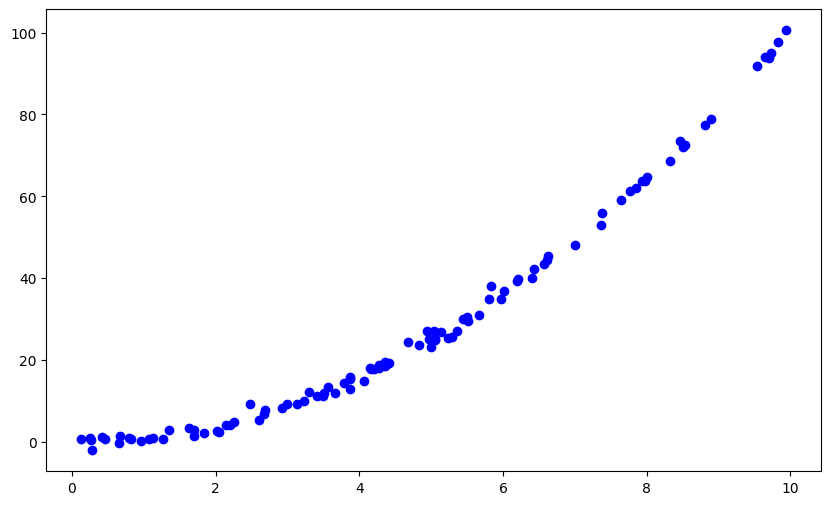

In [24]:
import matplotlib.pyplot as plt

y_hat = output[:, 1].detach().numpy()
plt.figure(figsize=(10, 6))  # Optional: specifies the figure size
plt.scatter(x, y, label='y1', color='blue', marker='o')  # Plot x vs. y1
plt.scatter(x, y_hat, label='y2', color='red', marker='s') 

In [7]:
np.random.seed(8)

x = np.random.uniform(low=0.001, high=1, size=100)

l = np.random.normal(0, 0.005, 100) 

y = [1/x + epsilon for x, epsilon in zip(x, epsilon)]

X = np.column_stack((x, y))

n = X.shape[0]
d = X.shape[1]

model = NotearsRKHS(n, d, "gaussian")
W_est, output = RKHS_nonlinear(model, X, lambda1=0.01, tau=0.01)
print(W_est)

rho:  1.0
h_val:  tensor(0., grad_fn=<SubBackward0>)
squared loss: 163.25222175627735
loss: 163.25222175627735
h_val:  tensor(57911412.4117, grad_fn=<SubBackward0>)
squared loss: 168.26275432136046
loss: 1676865843758326.5
h_val:  tensor(5.9015, grad_fn=<SubBackward0>)
squared loss: 161.87921283257648
loss: 179.29281472585103
h_val:  tensor(0.2297, grad_fn=<SubBackward0>)
squared loss: 162.47958442683552
loss: 162.50596842878653
h_val:  tensor(0.7449, grad_fn=<SubBackward0>)
squared loss: 161.71968804793494
loss: 161.99713041252318
h_val:  tensor(0.4112, grad_fn=<SubBackward0>)
squared loss: 161.38670954346614
loss: 161.47125558919737
h_val:  tensor(0.3048, grad_fn=<SubBackward0>)
squared loss: 161.17140920330363
loss: 161.2178471881018
h_val:  tensor(0.8849, grad_fn=<SubBackward0>)
squared loss: 160.37187780347972
loss: 160.76336315472003
h_val:  tensor(0.3749, grad_fn=<SubBackward0>)
squared loss: 160.30564609857495
loss: 160.3759193528235
h_val:  tensor(0.6038, grad_fn=<SubBackward0

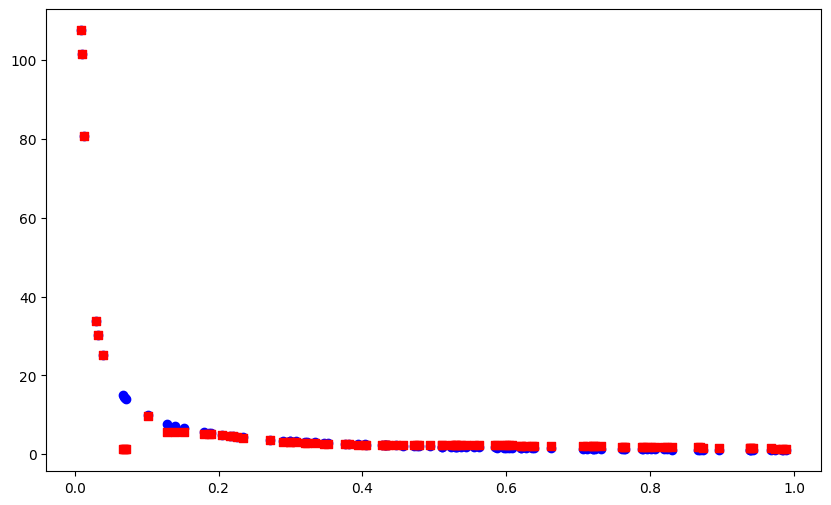

In [8]:
y_hat = output[:, 1].detach().numpy()
plt.figure(figsize=(10, 6))  # Optional: specifies the figure size
plt.scatter(x, y, label='y1', color='blue', marker='o')  # Plot x vs. y1
plt.scatter(x, y_hat, label='y2', color='red', marker='s') 

In [13]:
np.random.seed(1)
x = np.random.uniform(low=-10, high=10, size=100)

epsilon = np.random.normal(0,1, 100) 


y = [x**3 + x + epsilon for x, epsilon in zip(x, epsilon)]

y = np.array(y)  
X = np.column_stack((x, y))
n = X.shape[0]
d = X.shape[1]

print(n)
print(d)

model = NotearsRKHS(n, d, "gaussian")
W_est, output = RKHS_nonlinear(model, X, lambda1=0.01, tau=0.01)

100
2


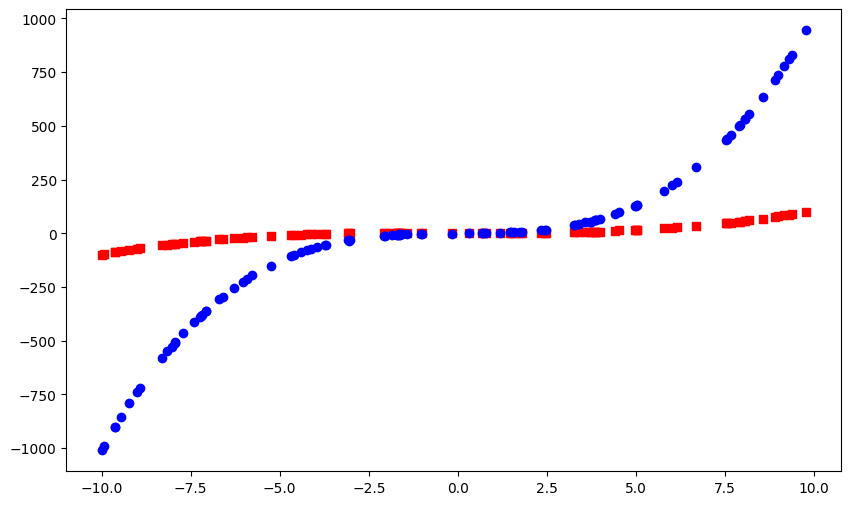

In [15]:
y_hat = output[:, 1].detach().numpy()
plt.figure(figsize=(10, 6))  # Optional: specifies the figure size
plt.scatter(x, y_hat, label='y2', color='red', marker='s') 
plt.scatter(x, y, label='y1', color='blue', marker='o')  # Plot x vs. y1

In [18]:
np.random.seed(2)
x = np.random.normal(0, 1, 100) 
#x = np.clip(x, -1.5, 1.5)

np.random.seed(24)
l = np.random.normal(0, 0.01, 100) 


y = [(np.sin(x) + epsilon) *10 for x, epsilon in zip(x, epsilon)]
y = np.array(y)


In [19]:
X = np.column_stack((x, y))
n = X.shape[0]
d = X.shape[1]


model = NotearsRKHS(n, d, "gaussian")
W_est, output = RKHS_nonlinear(model, X, lambda1=0.01, tau=0.01)


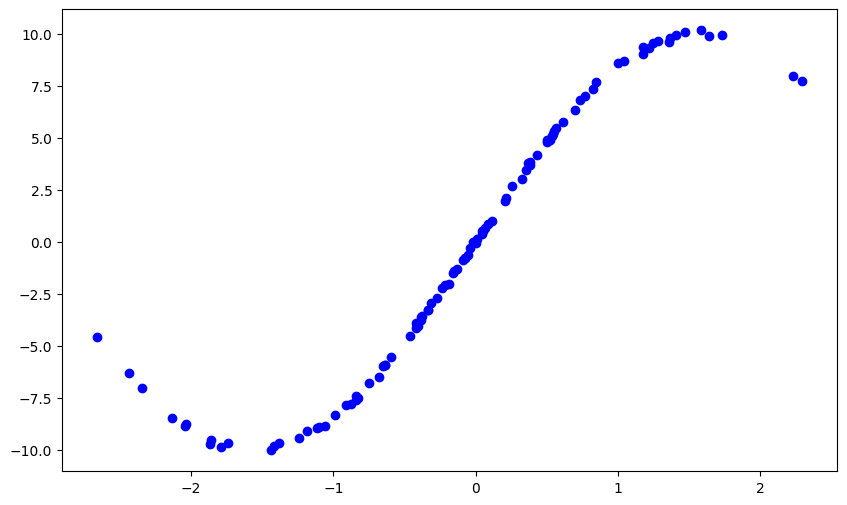

In [21]:
y_hat = output[:, 1].detach().numpy()
plt.figure(figsize=(10, 6))  # Optional: specifies the figure size
#plt.scatter(x, y_hat, label='y2', color='red', marker='s') 
plt.scatter(x, y, label='y1', color='blue', marker='o')  # Plot x vs. y1

### mutiple times

#### x**2

In [28]:
for i in range(10):    
    np.random.seed(i)
    x = np.random.normal(10,2, 100)
    l = np.random.normal(0,1, 100)  
    y = [x**2 + l for x, l in zip(x, l)]
    X = np.column_stack((x, y))

    model = NotearsRKHS(n, d, "gaussian")
    RKHS_nonlinear(model, X, lambda1=0.01)

[[2.11158326e-04 6.40444609e+00]
 [2.37937432e-05 1.36653587e-02]]
[[1.52887005e-03 1.12281315e+01]
 [1.61410804e-04 9.94580629e-02]]
[[6.93408234e-05 6.67924243e-01]
 [6.12150259e-05 8.48686180e-04]]
[[4.64184885e-04 7.21719336e+00]
 [2.39625566e-05 7.34277446e-03]]
[[2.27324232e-05 3.62407532e+00]
 [4.50680833e-06 2.66216901e-03]]
[[5.80120214e-04 8.82804280e+00]
 [1.28736883e-04 3.03153786e-02]]
[[2.54159811e-03 1.07426285e+01]
 [1.33927236e-04 6.43628133e-02]]
[[4.80764569e-04 7.51965717e+00]
 [9.24926158e-05 4.50787309e-02]]
[[2.20063170e-05 2.64438477e+00]
 [3.24071555e-05 9.82949121e-04]]
[[6.08207377e-04 8.80164900e+00]
 [7.53029212e-05 3.83012796e-02]]


#### x**3 + x

In [33]:
for i in range(10):    
    np.random.seed(i)
    x = np.random.normal(10,2, 100)
    l = np.random.normal(0,1, 100) 
    b = np.random.normal(0,1, 100) 
    z = [x**3 + x + b for x, b in zip(x, b)]
    X = np.column_stack((x, z))

    model = NotearsRKHS(n, d, "gaussian")
    RKHS_nonlinear(model, X, lambda1=0.01)

[[1.65458316e-04 1.88936337e-01]
 [1.05250087e-03 1.54760676e-03]]
[[4.44365236e-05 7.49452449e-02]
 [3.53134996e-03 5.06319121e-03]]
[[8.77382922e-05 3.22285690e-03]
 [1.16387989e-02 6.08145950e-03]]
[[0.00033586 0.13215855]
 [0.00255905 0.00038352]]
[[0.00016096 0.08585231]
 [0.00357075 0.00030365]]
[[4.55674705e-05 2.11820040e-02]
 [8.96806740e-03 1.21055241e-03]]
[[0.00020086 0.15241148]
 [0.00088426 0.00808896]]
[[4.00221085e-04 1.08314624e-05]
 [4.03466296e-01 2.98822647e-03]]
[[0.00030825 0.00039325]
 [0.09637115 0.00080477]]
[[0.00080118 0.00076255]
 [0.11973705 0.00082719]]


In [31]:
for i in range(10):    
    np.random.seed(i)
    x = np.random.normal(10,2, 100)
    x = np.clip(x, 1, 15)
    l = np.random.normal(0,1, 100)  
    y = [1/x + l for x, l in zip(x, l)]
    X = np.column_stack((x, y))

    model = NotearsRKHS(n, d, "gaussian")
    RKHS_nonlinear(model, X, lambda1=0.01)

[[2.91351123e-03 7.04374367e-05]
 [5.53790942e-01 6.51486887e-05]]
[[7.09649127e-04 2.54570708e-05]
 [4.00979094e-01 1.15359801e-05]]
[[2.14451721e-03 6.60473966e-05]
 [3.57962663e-01 2.66211230e-05]]
[[1.92830971e-03 3.38771729e-05]
 [5.60114822e-01 1.96387261e-05]]
[[1.98063374e-03 3.73562870e-05]
 [4.54047840e-01 1.75903183e-05]]
[[1.85720954e-03 3.97347798e-05]
 [5.81627651e-01 2.74726990e-05]]
[[2.11493553e-03 1.22481698e-04]
 [4.91597523e-01 6.58147997e-05]]
[[1.33515278e-03 3.83138378e-05]
 [4.98067032e-01 2.05211902e-05]]
[[9.88570115e-03 2.91170695e-05]
 [2.02765169e+00 6.34958048e-05]]


KeyboardInterrupt: 

In [88]:
for i in range(10):    
    np.random.seed(i)
    x = np.random.normal(10,2, 100)
    x = np.clip(x, 0, 15)
    l = np.random.normal(0,1, 100)  
    y = [np.sqrt(x) + l for x, l in zip(x, l)]
    X = np.column_stack((x, y))

    model = NotearsRKHS(n, d, "gaussian")
    RKHS_nonlinear(model, X, lambda1=0.01)

iteration:  1
iteration:  2
iteration:  3
iteration:  4
iteration:  5
iteration:  6
iteration:  7
[[4.64493164e-03 2.81679310e-04]
 [1.41625340e+00 4.09609102e-04]]
iteration:  1
iteration:  2
iteration:  3
iteration:  4
iteration:  5
iteration:  6
iteration:  7
iteration:  8
iteration:  9
[[1.80825010e-03 2.73835442e-04]
 [4.33336789e-01 1.70054897e-04]]
iteration:  1
iteration:  2
iteration:  3
iteration:  4
iteration:  5
iteration:  6
iteration:  7
iteration:  8
iteration:  9
[[9.05707134e-04 1.24196363e-04]
 [4.19094861e-01 4.81038726e-05]]
iteration:  1
iteration:  2
iteration:  3
iteration:  4
iteration:  5
iteration:  6
iteration:  7
iteration:  8
[[1.37237773e-03 9.52793978e-05]
 [4.34650632e-01 3.91684163e-05]]
iteration:  1
iteration:  2
iteration:  3
iteration:  4
iteration:  5
iteration:  6
iteration:  7
iteration:  8
[[2.66122250e-03 2.73627353e-04]
 [7.42556856e-01 1.69069137e-04]]
iteration:  1
iteration:  2
iteration:  3
iteration:  4
iteration:  5
iteration:  6
iterati

### log determinant h

In [98]:
np.random.seed(2)
x = np.random.normal(10,2, 100)

np.random.seed(24)
l = np.random.normal(0,1, 100) 

# marker
np.random.seed(25)
b = np.random.normal(0,1, 100) 


y = [x**2 + l for x, l in zip(x, l)]

X = np.column_stack((x, y))
n = X.shape[0]
d = X.shape[1]

print(n)
print(d)

model = NotearsRKHS(n, d, "gaussian")
RKHS_nonlinear(model, X, lambda1=0.01)

100
2
rho:  1.0
h_val:  tensor(0., grad_fn=<AddBackward0>)
loss: 5889.293525997783
h_val:  tensor(7.6715e-05, grad_fn=<AddBackward0>)
loss: 5865.228427454175
h_val:  tensor(0.0019, grad_fn=<AddBackward0>)
loss: 5770.456059863189
h_val:  tensor(0.0344, grad_fn=<AddBackward0>)
loss: 5415.175568605292
h_val:  tensor(0.1961, grad_fn=<AddBackward0>)
loss: 3662.044298467087
h_val:  tensor(0.2009, grad_fn=<AddBackward0>)
loss: 3431.2178442899726
h_val:  tensor(0.3599, grad_fn=<AddBackward0>)
loss: 3196.5286327525637
h_val:  tensor(0.4621, grad_fn=<AddBackward0>)
loss: 3146.0635905600825
h_val:  tensor(0.6218, grad_fn=<AddBackward0>)
loss: 3121.4113705633813
h_val:  tensor(0.6970, grad_fn=<AddBackward0>)
loss: 3113.1582962043667
h_val:  tensor(0.7538, grad_fn=<AddBackward0>)
loss: 3111.88876567714
h_val:  tensor(0.7759, grad_fn=<AddBackward0>)
loss: 3111.286147583239
h_val:  tensor(0.7769, grad_fn=<AddBackward0>)
loss: 3111.2014416649104
h_val:  tensor(0.7838, grad_fn=<AddBackward0>)
loss: 311

array([[1., 1.],
       [1., 1.]])

In [81]:
# t = 100
np.random.seed(2)
x = np.random.normal(10,2, 100)

np.random.seed(24)
l = np.random.normal(0,1, 100) 

# marker
np.random.seed(25)
b = np.random.normal(0,1, 100) 

z = [x**3 + x + b for x, b in zip(x, b)]

X = np.column_stack((x, z))
n = X.shape[0]
d = X.shape[1]

print(n)
print(d)

model = NotearsRKHS(n, d, "gaussian")
RKHS_nonlinear(model, X, lambda1=0.01)

100
2
rho:  1.0
h_val:  tensor(0., grad_fn=<AddBackward0>)
loss: 769241.416472829
h_val:  tensor(0.0012, grad_fn=<AddBackward0>)
loss: 769092.1191582498
h_val:  tensor(0.0309, grad_fn=<AddBackward0>)
loss: 768495.4316745593
h_val:  tensor(0.7709, grad_fn=<AddBackward0>)
loss: 766116.9972853493
h_val:  tensor(-2.0547, grad_fn=<AddBackward0>)
loss: 756732.2195396795
h_val:  tensor(-3.2647, grad_fn=<AddBackward0>)
loss: 747508.4505826177
h_val:  tensor(-8.9993, grad_fn=<AddBackward0>)
loss: 513590.2492380673
h_val:  tensor(-8.7597, grad_fn=<AddBackward0>)
loss: 494827.1679242778
h_val:  tensor(-8.4889, grad_fn=<AddBackward0>)
loss: 493295.3382720742
h_val:  tensor(-8.5158, grad_fn=<AddBackward0>)
loss: 493253.47137444885
h_val:  tensor(-8.5151, grad_fn=<AddBackward0>)
loss: 493249.78303791763
h_val:  tensor(-8.5133, grad_fn=<AddBackward0>)
loss: 493249.4650993037
h_val:  tensor(-8.5046, grad_fn=<AddBackward0>)
loss: 493248.38674677553
h_val:  tensor(-8.4919, grad_fn=<AddBackward0>)
loss: 

array([[0., 1.],
       [1., 1.]])

In [94]:
np.random.seed(2)
x = np.random.normal(10, 2, 100) 
x = np.clip(x, 5, 15)

np.random.seed(24)
l = np.random.normal(0, 1, 100) 

# marker
np.random.seed(25)
b = np.random.normal(0,1, 100) 


y = [1/x + l for x, l in zip(x, l)]
#z = [np.log(np.abs(x)) + b for x, b in zip(x, b)]

X = np.column_stack((x, y))

n = X.shape[0]
d = X.shape[1]

print(n)
print(d)

model = NotearsRKHS(n, d, "gaussian")
RKHS_nonlinear(model, X, lambda1=0.01)

100
2
rho:  1.0
h_val:  tensor(0., grad_fn=<AddBackward0>)
loss: 50.67251412588623
h_val:  tensor(0.0050, grad_fn=<AddBackward0>)
loss: 39.29286578954085
h_val:  tensor(0.0935, grad_fn=<AddBackward0>)
loss: 20.14747315163566
h_val:  tensor(0.0809, grad_fn=<AddBackward0>)
loss: 18.78550194417518
h_val:  tensor(0.0443, grad_fn=<AddBackward0>)
loss: 13.746108758278092
h_val:  tensor(0.0399, grad_fn=<AddBackward0>)
loss: 12.78553304831766
h_val:  tensor(0.0412, grad_fn=<AddBackward0>)
loss: 12.196237030476146
h_val:  tensor(0.0410, grad_fn=<AddBackward0>)
loss: 11.860648212301887
h_val:  tensor(0.0386, grad_fn=<AddBackward0>)
loss: 11.698710135791709
h_val:  tensor(0.0362, grad_fn=<AddBackward0>)
loss: 11.524673706926212
h_val:  tensor(0.0329, grad_fn=<AddBackward0>)
loss: 11.306434338001054
h_val:  tensor(0.0282, grad_fn=<AddBackward0>)
loss: 11.104841479454114
h_val:  tensor(0.0260, grad_fn=<AddBackward0>)
loss: 11.041186450853901
h_val:  tensor(0.0267, grad_fn=<AddBackward0>)
loss: 10.9

array([[0., 0.],
       [1., 0.]])

In [81]:
np.random.seed(2)
x = np.random.normal(10, 2, 100) 
x = np.clip(x, 5, 15)

np.random.seed(24)
l = np.random.normal(0, 1, 100) 

# marker
np.random.seed(25)
b = np.random.normal(0,1, 100) 


y = [x**(-2) + l for x, l in zip(x, l)]
#z = [np.log(np.abs(x)) + b for x, b in zip(x, b)]

X = np.column_stack((x, y))

n = X.shape[0]
d = X.shape[1]

print(n)
print(d)

model = NotearsRKHS(n, d, "gaussian")
RKHS_nonlinear(model, X, lambda1=0.01)

100
2
rho:  1.0
h_val:  tensor(0., grad_fn=<SubBackward0>)
loss: 50.655564958707686
h_val:  tensor(0.6412, grad_fn=<SubBackward0>)
loss: 39.48396061987466
h_val:  tensor(28.4619, grad_fn=<SubBackward0>)
loss: 424.900959698558
h_val:  tensor(1.9089, grad_fn=<SubBackward0>)
loss: 32.98929406240496
h_val:  tensor(4.8250, grad_fn=<SubBackward0>)
loss: 31.94983175487296
h_val:  tensor(2.0388, grad_fn=<SubBackward0>)
loss: 29.250942612440202
h_val:  tensor(3.1922, grad_fn=<SubBackward0>)
loss: 23.518130211787664
h_val:  tensor(3.9390, grad_fn=<SubBackward0>)
loss: 25.486385222933084
h_val:  tensor(2.6109, grad_fn=<SubBackward0>)
loss: 21.474925172430222
h_val:  tensor(1.7190, grad_fn=<SubBackward0>)
loss: 20.424324501216994
h_val:  tensor(1.9435, grad_fn=<SubBackward0>)
loss: 19.578643860097174
h_val:  tensor(2.1225, grad_fn=<SubBackward0>)
loss: 17.703039078978566
h_val:  tensor(2.9311, grad_fn=<SubBackward0>)
loss: 17.979776671997314
h_val:  tensor(2.1448, grad_fn=<SubBackward0>)
loss: 16.

array([[0., 0.],
       [1., 0.]])

In [83]:
# t = 1
np.random.seed(2)
x = np.random.normal(0, 1, 100) 
x = np.clip(x, -1.5, 1.5)

np.random.seed(24)
l = np.random.normal(0, 1, 100) 

# marker
np.random.seed(25)
b = np.random.normal(0,1, 100) 


y = [np.sin(x) + l for x, l in zip(x, l)]
#z = [np.log(np.abs(x)) + b for x, b in zip(x, b)]

X = np.column_stack((x, y))
n = X.shape[0]
d = X.shape[1]

print(n)
print(d)

model = NotearsRKHS(n, d, "gaussian")
RKHS_nonlinear(model, X, lambda1=0.01)

100
2
rho:  1.0
h_val:  tensor(0., grad_fn=<AddBackward0>)
loss: 1.1900979152330582
h_val:  tensor(1.2966, grad_fn=<AddBackward0>)
loss: 1.4943909119392182
h_val:  tensor(0.0231, grad_fn=<AddBackward0>)
loss: 1.0242162147081262
h_val:  tensor(1.7690, grad_fn=<AddBackward0>)
loss: 2.070150775037954
h_val:  tensor(0.2748, grad_fn=<AddBackward0>)
loss: 0.7525466344306379
h_val:  tensor(0.5047, grad_fn=<AddBackward0>)
loss: 0.690799186446792
h_val:  tensor(0.4076, grad_fn=<AddBackward0>)
loss: 0.6269223559119063
h_val:  tensor(0.4122, grad_fn=<AddBackward0>)
loss: 0.5688528833394457
h_val:  tensor(0.3707, grad_fn=<AddBackward0>)
loss: 0.5343611343827978
h_val:  tensor(0.3599, grad_fn=<AddBackward0>)
loss: 0.5160429968134157
h_val:  tensor(0.3683, grad_fn=<AddBackward0>)
loss: 0.4965228672972907
h_val:  tensor(0.3788, grad_fn=<AddBackward0>)
loss: 0.4843936732674315
h_val:  tensor(0.3785, grad_fn=<AddBackward0>)
loss: 0.4779393496779679
h_val:  tensor(0.3791, grad_fn=<AddBackward0>)
loss: 0

array([[0., 0.],
       [0., 0.]])

In [80]:
# t = 1
np.random.seed(2)
x = np.random.normal(0, 1, 100) 
x = np.clip(x, -1.5, 1.5)

np.random.seed(24)
l = np.random.normal(0, 1, 100) 

# marker
np.random.seed(25)
b = np.random.normal(0,1, 100) 


y = [np.cos(x) + l for x, l in zip(x, l)]
#z = [np.log(np.abs(x)) + b for x, b in zip(x, b)]

X = np.column_stack((x, y))
n = X.shape[0]
d = X.shape[1]

print(n)
print(d)

model = NotearsRKHS(n, d, "gaussian")
RKHS_nonlinear(model, X, lambda1=0.01)

100
2
rho:  1.0
h_val:  tensor(0., grad_fn=<SubBackward0>)
loss: 1.2286329610115632
h_val:  tensor(5.5727, grad_fn=<SubBackward0>)
loss: 17.028189228933314
h_val:  tensor(0.2320, grad_fn=<SubBackward0>)
loss: 0.7299227298483996
h_val:  tensor(0.4561, grad_fn=<SubBackward0>)
loss: 0.6495701918365879
h_val:  tensor(0.4021, grad_fn=<SubBackward0>)
loss: 0.5975897354921057
h_val:  tensor(0.3726, grad_fn=<SubBackward0>)
loss: 0.5527806064754488
h_val:  tensor(0.3763, grad_fn=<SubBackward0>)
loss: 0.4932682015771257
h_val:  tensor(0.3797, grad_fn=<SubBackward0>)
loss: 0.4665869008717076
h_val:  tensor(0.4141, grad_fn=<SubBackward0>)
loss: 0.4715492085160695
h_val:  tensor(0.3883, grad_fn=<SubBackward0>)
loss: 0.4632169649930245
h_val:  tensor(0.3970, grad_fn=<SubBackward0>)
loss: 0.45993103520999223
h_val:  tensor(0.4073, grad_fn=<SubBackward0>)
loss: 0.4565271877050975
h_val:  tensor(0.4131, grad_fn=<SubBackward0>)
loss: 0.45282006000477554
h_val:  tensor(0.4129, grad_fn=<SubBackward0>)
los

array([[0., 0.],
       [0., 0.]])

### Spectrum h

In [50]:
np.random.seed(2)
x = np.random.normal(10,2, 100)

np.random.seed(24)
l = np.random.normal(0,1, 100) 

# marker
np.random.seed(25)
b = np.random.normal(0,1, 100) 


y = [x**2 + l for x, l in zip(x, l)]

X = np.column_stack((x, y))
n = X.shape[0]
d = X.shape[1]


model = NotearsRKHS(n, d, "gaussian")
RKHS_nonlinear(model, X, lambda1=0.01)

rho:  1.0
h_val:  tensor(0., grad_fn=<DotBackward0>)
loss: 5889.293525997783
h_val:  tensor(0.0153, grad_fn=<DotBackward0>)
loss: 5865.228545139438
h_val:  tensor(0.3836, grad_fn=<DotBackward0>)
loss: 5770.52961333295
h_val:  tensor(6.7658, grad_fn=<DotBackward0>)
loss: 5438.063155743376
h_val:  tensor(64.5087, grad_fn=<DotBackward0>)
loss: 6247.084985231239
h_val:  tensor(20.6739, grad_fn=<DotBackward0>)
loss: 5062.5725122300955
h_val:  tensor(31.5448, grad_fn=<DotBackward0>)
loss: 4920.5774605035
h_val:  tensor(20.4636, grad_fn=<DotBackward0>)
loss: 4696.770188326497
h_val:  tensor(20.9458, grad_fn=<DotBackward0>)
loss: 4560.584067583307
h_val:  tensor(21.5467, grad_fn=<DotBackward0>)
loss: 4294.0019529398605
h_val:  tensor(24.4630, grad_fn=<DotBackward0>)
loss: 4211.475401161598
h_val:  tensor(19.2285, grad_fn=<DotBackward0>)
loss: 4090.490729019853
h_val:  tensor(18.8026, grad_fn=<DotBackward0>)
loss: 4023.963161252718
h_val:  tensor(18.6044, grad_fn=<DotBackward0>)
loss: 3964.4143

array([[0., 1.],
       [0., 1.]])

In [51]:
np.random.seed(2)
x = np.random.normal(10,2, 100)

np.random.seed(24)
l = np.random.normal(0,1, 100) 

# marker
np.random.seed(25)
b = np.random.normal(0,1, 100) 



z = [x**3 + x + b for x, b in zip(x, b)]

X = np.column_stack((x, z))
n = X.shape[0]
d = X.shape[1]

print(n)
print(d)

model = NotearsRKHS(n, d, "gaussian")
RKHS_nonlinear(model, X, lambda1=0.01)

100
2
rho:  1.0
h_val:  tensor(0., grad_fn=<DotBackward0>)
loss: 769241.416472829
h_val:  tensor(0.0012, grad_fn=<DotBackward0>)
loss: 769092.1191582489
h_val:  tensor(0.0305, grad_fn=<DotBackward0>)
loss: 768495.4316600151
h_val:  tensor(0.5374, grad_fn=<DotBackward0>)
loss: 766116.8445456945
h_val:  tensor(8.8044, grad_fn=<DotBackward0>)
loss: 756768.8670773807
h_val:  tensor(141.6997, grad_fn=<DotBackward0>)
loss: 731276.4638118971
h_val:  tensor(170.1094, grad_fn=<DotBackward0>)
loss: 693230.2707890398
h_val:  tensor(450.2028, grad_fn=<DotBackward0>)
loss: 669039.6416430797
h_val:  tensor(186.3590, grad_fn=<DotBackward0>)
loss: 635851.4712769073
h_val:  tensor(457.5418, grad_fn=<DotBackward0>)
loss: 663855.0236907185
h_val:  tensor(224.5828, grad_fn=<DotBackward0>)
loss: 612974.0566722321
h_val:  tensor(245.5853, grad_fn=<DotBackward0>)
loss: 594712.9671142108
h_val:  tensor(213.8066, grad_fn=<DotBackward0>)
loss: 570254.94983418
h_val:  tensor(157.3655, grad_fn=<DotBackward0>)
los

array([[0., 1.],
       [0., 0.]])

In [52]:
np.random.seed(2)
x = np.random.normal(10, 2, 100) 
x = np.clip(x, 5, 15)

np.random.seed(24)
l = np.random.normal(0, 1, 100) 

# marker
np.random.seed(25)
b = np.random.normal(0,1, 100) 


y = [1/x + l for x, l in zip(x, l)]
#z = [np.log(np.abs(x)) + b for x, b in zip(x, b)]

X = np.column_stack((x, y))
n = X.shape[0]
d = X.shape[1]

print(n)
print(d)

model = NotearsRKHS(n, d, "gaussian")
RKHS_nonlinear(model, X, lambda1=0.01)

100
2
rho:  1.0
h_val:  tensor(0., grad_fn=<DotBackward0>)
loss: 50.67251412588623
h_val:  tensor(0.4938, grad_fn=<DotBackward0>)
loss: 39.4147788235307
h_val:  tensor(4.6843, grad_fn=<DotBackward0>)
loss: 29.990109602420993
h_val:  tensor(1.9584, grad_fn=<DotBackward0>)
loss: 21.66659626644676
h_val:  tensor(2.1851, grad_fn=<DotBackward0>)
loss: 20.190096169545477
h_val:  tensor(1.9852, grad_fn=<DotBackward0>)
loss: 16.705060329096302
h_val:  tensor(3.9620, grad_fn=<DotBackward0>)
loss: 21.289097935584643
h_val:  tensor(1.9878, grad_fn=<DotBackward0>)
loss: 16.149969316524505
h_val:  tensor(1.8926, grad_fn=<DotBackward0>)
loss: 15.422858735638906
h_val:  tensor(1.8126, grad_fn=<DotBackward0>)
loss: 15.059881308117594
h_val:  tensor(1.6595, grad_fn=<DotBackward0>)
loss: 14.15120873821263
h_val:  tensor(1.5014, grad_fn=<DotBackward0>)
loss: 13.423458929169476
h_val:  tensor(1.4525, grad_fn=<DotBackward0>)
loss: 13.071910826138165
h_val:  tensor(1.3478, grad_fn=<DotBackward0>)
loss: 12.8

array([[0., 0.],
       [1., 0.]])

In [53]:
np.random.seed(2)
x = np.random.normal(0, 1, 100) 
x = np.clip(x, -1.5, 1.5)

np.random.seed(24)
l = np.random.normal(0, 1, 100) 

# marker
np.random.seed(25)
b = np.random.normal(0,1, 100) 


y = [np.sin(x) + l for x, l in zip(x, l)]
#z = [np.log(np.abs(x)) + b for x, b in zip(x, b)]

X = np.column_stack((x, y))
n = X.shape[0]
d = X.shape[1]

print(n)
print(d)

model = NotearsRKHS(n, d, "gaussian")
RKHS_nonlinear(model, X, lambda1=0.01)

100
2
rho:  1.0
h_val:  tensor(0., grad_fn=<DotBackward0>)
loss: 1.1900979152330582
h_val:  tensor(1.5194, grad_fn=<DotBackward0>)
loss: 1.8080532107258245
h_val:  tensor(0.2803, grad_fn=<DotBackward0>)
loss: 0.7208716682062338
h_val:  tensor(0.4241, grad_fn=<DotBackward0>)
loss: 0.5978035055670587
h_val:  tensor(0.4305, grad_fn=<DotBackward0>)
loss: 0.5089413122767208
h_val:  tensor(0.4110, grad_fn=<DotBackward0>)
loss: 0.4609133352626624
h_val:  tensor(0.3819, grad_fn=<DotBackward0>)
loss: 0.4496033683204864
h_val:  tensor(0.3793, grad_fn=<DotBackward0>)
loss: 0.43800243201632544
h_val:  tensor(0.3878, grad_fn=<DotBackward0>)
loss: 0.4229479462873812
h_val:  tensor(0.3812, grad_fn=<DotBackward0>)
loss: 0.40830378433209064
h_val:  tensor(0.3833, grad_fn=<DotBackward0>)
loss: 0.39423127998428253
h_val:  tensor(0.3632, grad_fn=<DotBackward0>)
loss: 0.3918422246351183
h_val:  tensor(0.3617, grad_fn=<DotBackward0>)
loss: 0.38740585389635424
h_val:  tensor(0.3629, grad_fn=<DotBackward0>)
l

array([[0., 1.],
       [0., 0.]])

### Improvement 

Standardize the data --> worse result
plot loss wrt rho and alpha in log scale (contour loss) in P29
add linear combination of the kernel to the representer Theorem (Proof it by paper prop 3 and 4)
Try real L2 measure
18.02 10:00 meeting
plot y wrt x and f_hat(x) wrt x for tubing data

1) Find best scaler wrt x
2) Do multiple times scaler
3) Do refinement above